# AstroCLIP Figures


In [2]:
%pylab inline 

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


In [3]:
# Path to the embeddings prepared by the model
filename = 'data/siavash_embeddings_73j9jeic_1p1p5.npz'


# Extracting information 
data = np.load(filename)
z = data['redshift']
image_features = data['image_features']
spectrum_features = data['spectrum_features']
images = data['images']
spectra = data['spectra']
targetid = data['targetid']

## Visualizing Embeddings

In this section, we use a PCA to extract the main axes of variations of the embedded data.

In [4]:
# Code borrowed from https://github.com/georgestein/ssl-legacysurvey
import matplotlib.pyplot as plt
import matplotlib.patches as patches

from scipy.stats import binned_statistic_2d

def scatter_plot_as_images(z_emb, nx=8, ny=8, npix_show=96, iseed=13579, display_image=True):
    """Sample points from scatter plot and display as their original galaxy image
        
    Parameters
    ----------
    DDL : class instance
        DecalsDataLoader class instance
    z_emb: array
        (N, 2) array of the galaxies location in some compressed space. 
        If second axis has a dimensionality greater than 2 we only consider the leading two components.
    """
    z_emb = z_emb[:, :2] # keep only first two dimensions

    nplt = nx*ny

    img_full = np.zeros((ny*npix_show, nx*npix_show, 3)) + 255#, dtype=np.uint8) + 255

    xmin = z_emb[:,0].min()
    xmax = z_emb[:,0].max()
    ymin = z_emb[:,1].min()
    ymax = z_emb[:,1].max()

    dz_emb = 0.25
    dx_cent = z_emb[:,0].mean()
    dy_cent = z_emb[:,1].mean()

    dx_cent = 10.0
    dy_cent = 7.0

    # xmin = dx_cent - dz_emb
    # xmax = dx_cent + dz_emb
    # ymin = dy_cent - dz_emb
    # ymax = dy_cent + dz_emb

    binx = np.linspace(xmin,xmax, nx+1)
    biny = np.linspace(ymin,ymax, ny+1)

    ret = binned_statistic_2d(z_emb[:,0], z_emb[:,1], z_emb[:,1], 'count', bins=[binx, biny], expand_binnumbers=True)
    z_emb_bins = ret.binnumber.T

    inds_used = []
    inds_lin = np.arange(z_emb.shape[0])

    # First get all indexes that will be used
    for ix in range(nx):
        for iy in range(ny):
            dm = (z_emb_bins[:,0]==ix) & (z_emb_bins[:,1]==iy)
            inds = inds_lin[dm]

            np.random.seed(ix*nx+iy+iseed)
            if len(inds) > 0:
                ind_plt = np.random.choice(inds)
                inds_used.append(ind_plt)# inds_use[ind_plt])

    # load in all images
    iimg = 0
    
    # Add each image as postage stamp in desired region  
    for ix in range(nx):
        for iy in range(ny):
            dm = (z_emb_bins[:,0] == ix) & (z_emb_bins[:,1]==iy)
            inds = inds_lin[dm]

            np.random.seed(ix*nx+iy+iseed)
            if len(inds) > 0:

                imi = images[inds[0]][28:-28, 28:-28]
                img_full[iy*npix_show:(iy+1)*npix_show, ix*npix_show:(ix+1)*npix_show] = imi

                iimg += 1
                
    if display_image:
        plt.figure(figsize=(nx, ny))
        plt.imshow(img_full, origin='lower')#, interpolation='none')
        plt.axis('off')
        
    return img_full

In [5]:
from sklearn.decomposition import PCA
im_pca = PCA(n_components=4).fit_transform(image_features/np.linalg.norm(image_features, axis=-1, keepdims=True))
sp_pca = PCA(n_components=4).fit_transform(spectrum_features/np.linalg.norm(spectrum_features, axis=-1, keepdims=True))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


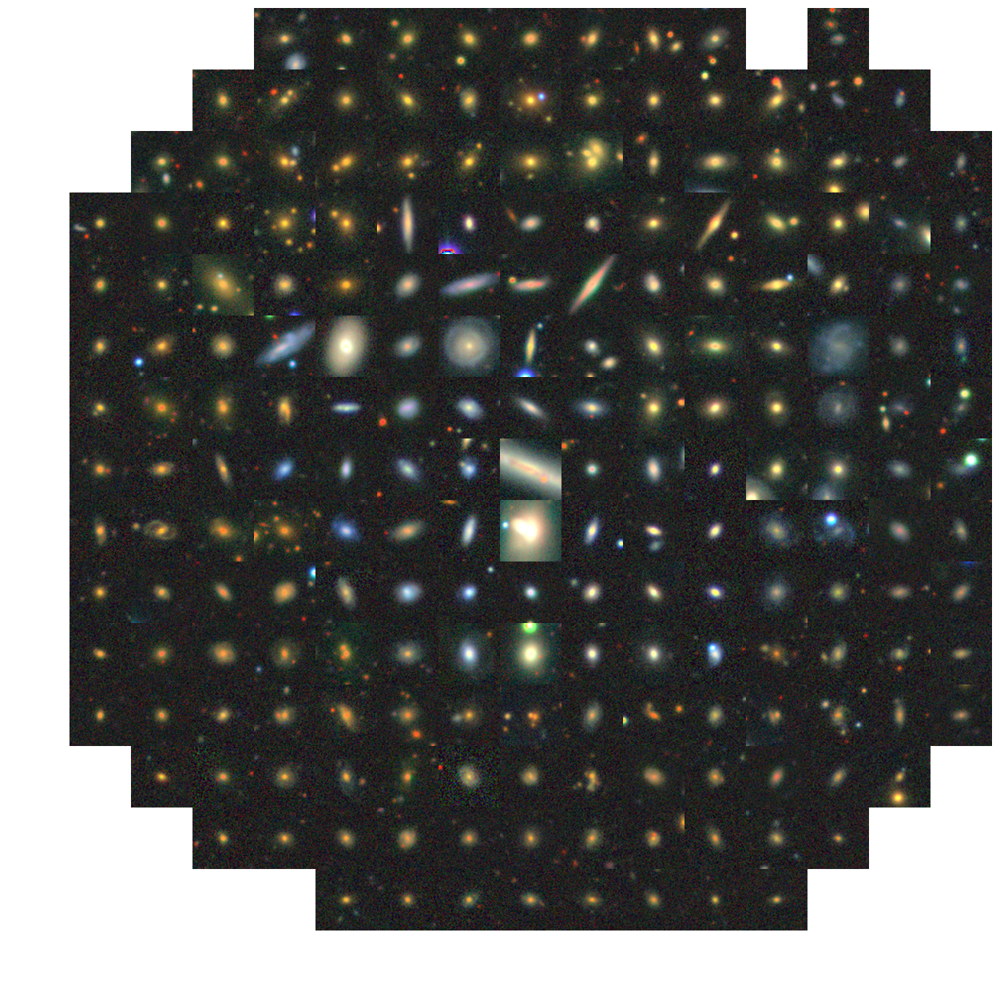

In [6]:
# Embedding from images
scatter_plot_as_images(im_pca, nx=16, ny=16);

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


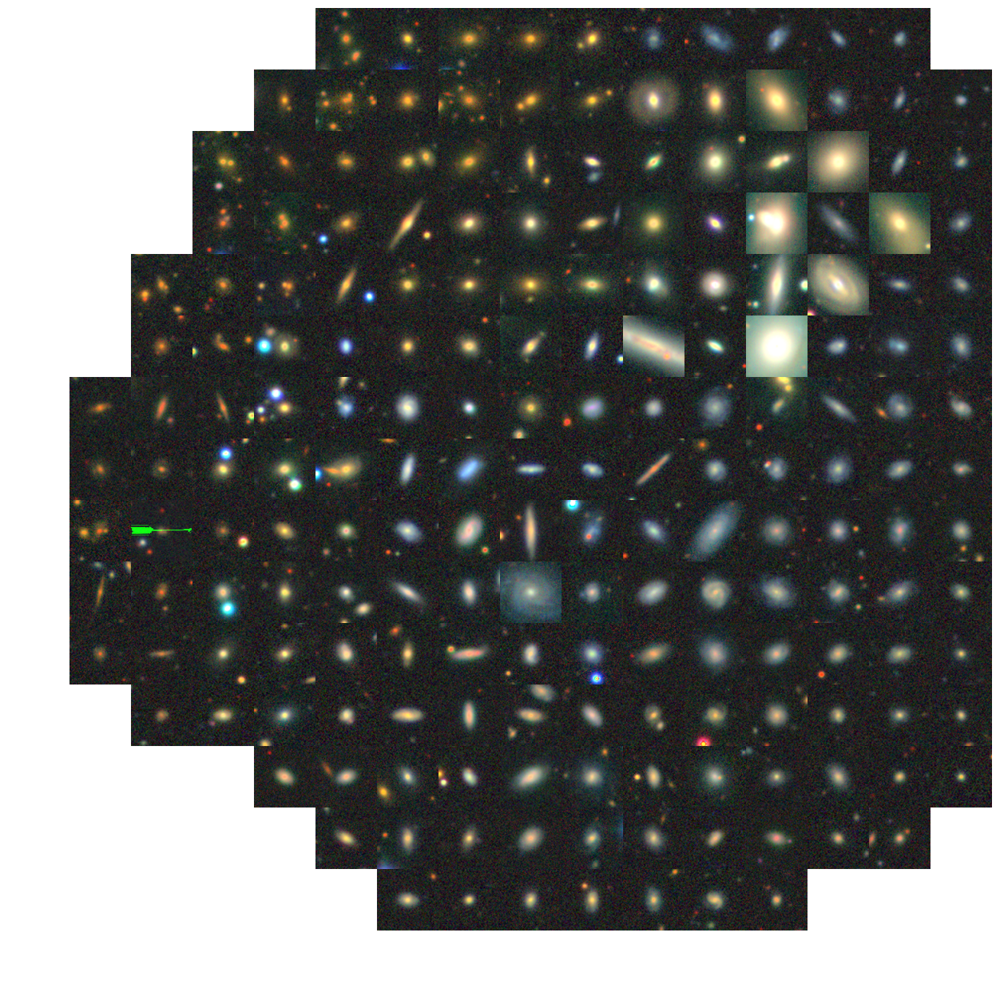

In [7]:
# Embedding from images, but along the next PCA components
scatter_plot_as_images(im_pca[:,2:4], nx=16, ny=16);

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


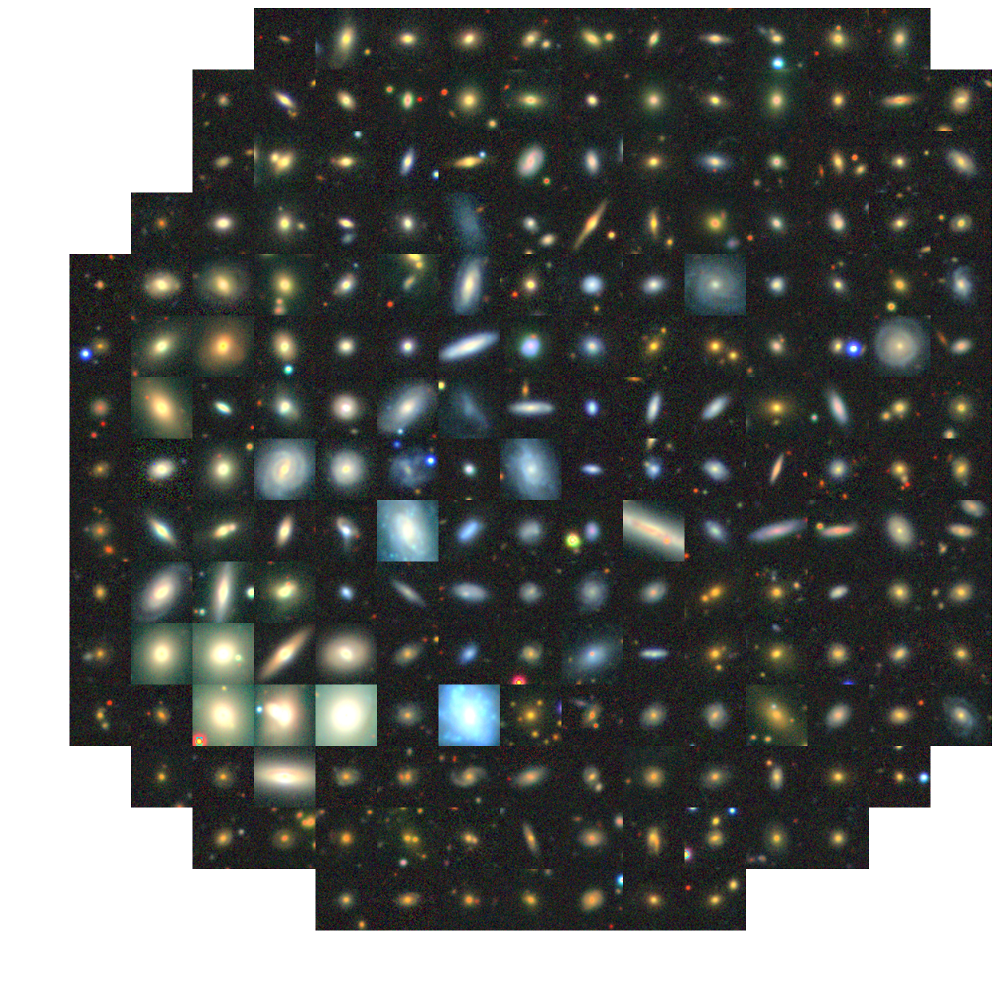

In [8]:
# Embedding from spectra
scatter_plot_as_images(sp_pca, nx=16, ny=16);

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


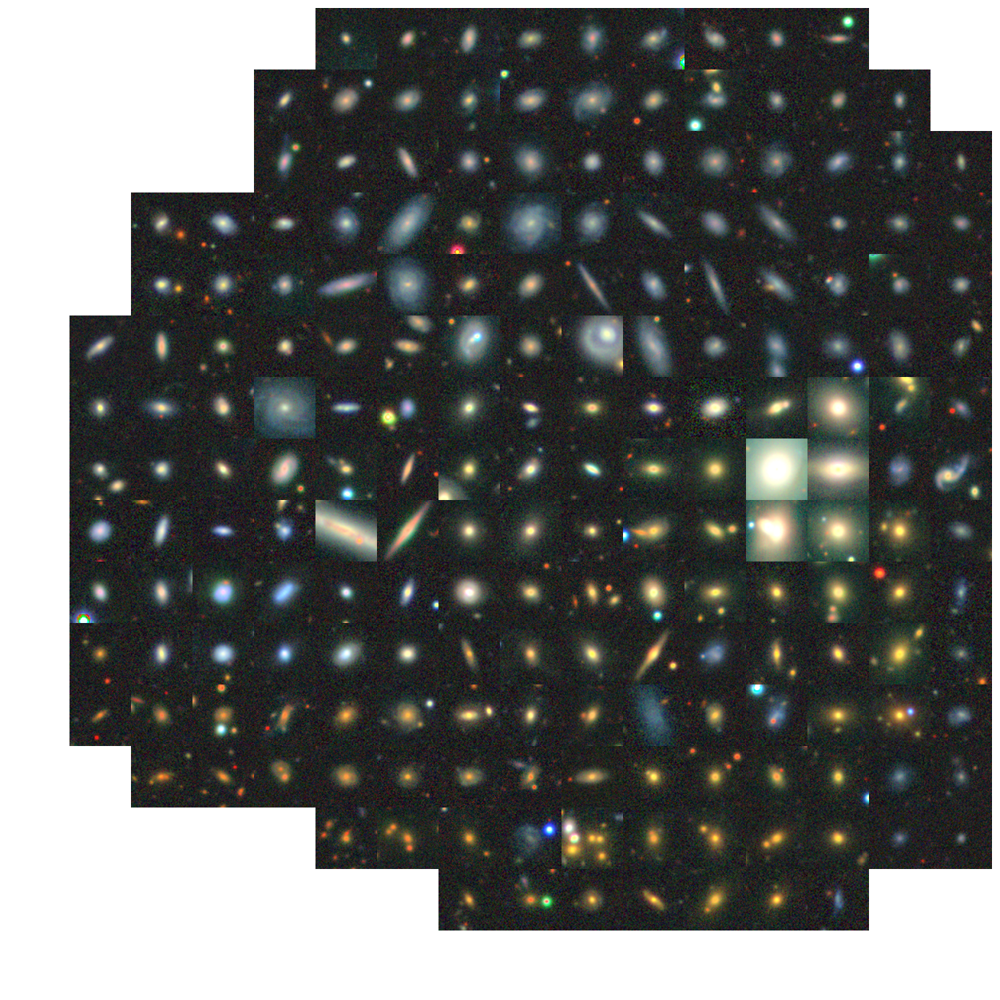

In [9]:
# Embedding from spectra
scatter_plot_as_images(sp_pca[:,2:4], nx=16, ny=16);

## Testing Neighbor Retrieval

In [10]:
# Index of galaxy to retrieve
from scipy.ndimage import gaussian_filter1d
from sklearn.metrics.pairwise import cosine_similarity
ind_query = 2626

In [11]:
l = np.linspace(3586.7408577, 10372.89543574, spectra.shape[1])

(0.0, 20.0)

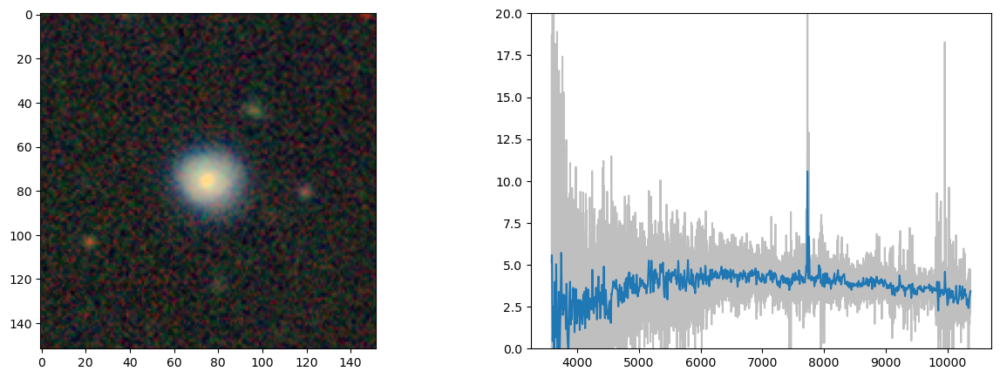

In [12]:
figure(figsize=[15,5])
subplot(121)
imshow(images[ind_query])
subplot(122)
plot(l,spectra[ind_query], color='grey', alpha=0.5)
plot(l,gaussian_filter1d(spectra[ind_query][:,0],5))
ylim(-0,20)

In [13]:
# Computing similarities
image_features_normed = image_features / np.linalg.norm(image_features, axis=-1, keepdims=True)
spectrum_features_normed = spectrum_features / np.linalg.norm(spectrum_features, axis=-1, keepdims=True)

spectral_similarity = spectrum_features_normed[ind_query] @ spectrum_features_normed.T
image_similarity = image_features_normed[ind_query] @ image_features_normed.T
cross_image_similarity = image_features_normed[ind_query] @ spectrum_features_normed.T
cross_spectral_similarity = spectrum_features_normed[ind_query] @ image_features_normed.T

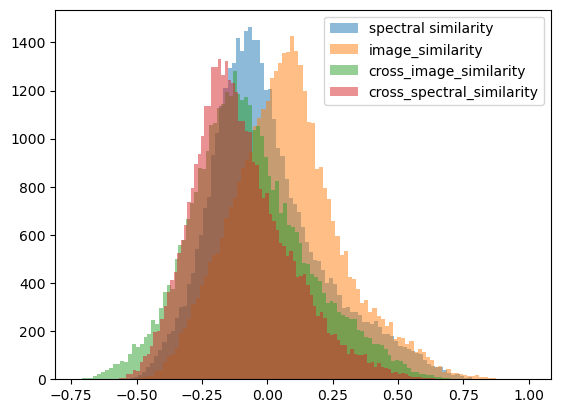

In [14]:
hist(spectral_similarity,100, label='spectral similarity', alpha=0.5);
hist(image_similarity,100, label='image_similarity', alpha=0.5);
hist(cross_image_similarity,100, label='cross_image_similarity', alpha=0.5);
hist(cross_spectral_similarity,100, label='cross_spectral_similarity', alpha=0.5);
legend()

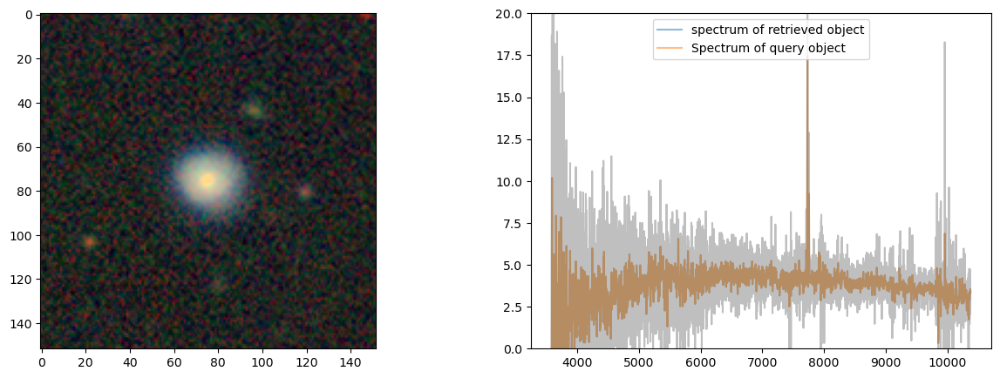

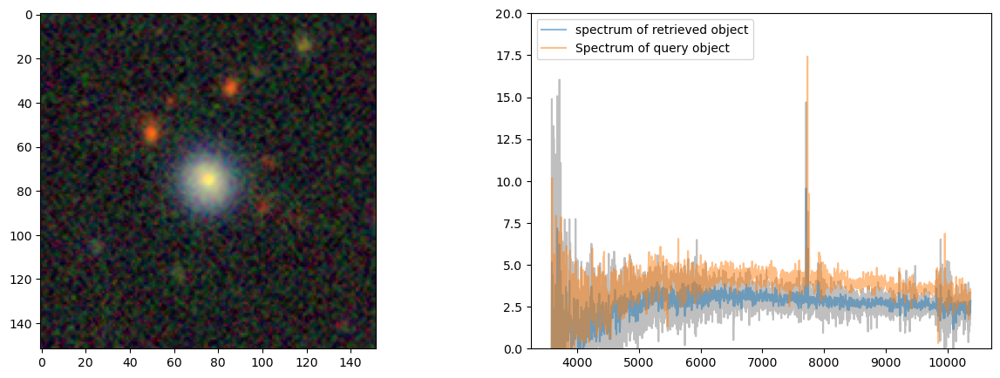

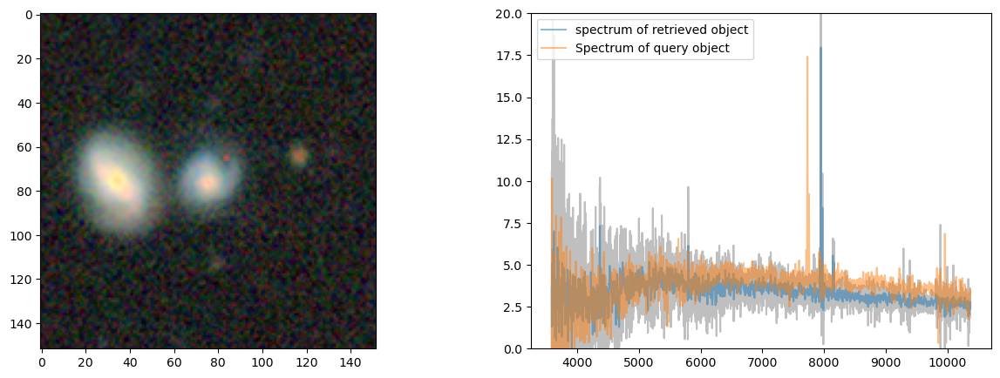

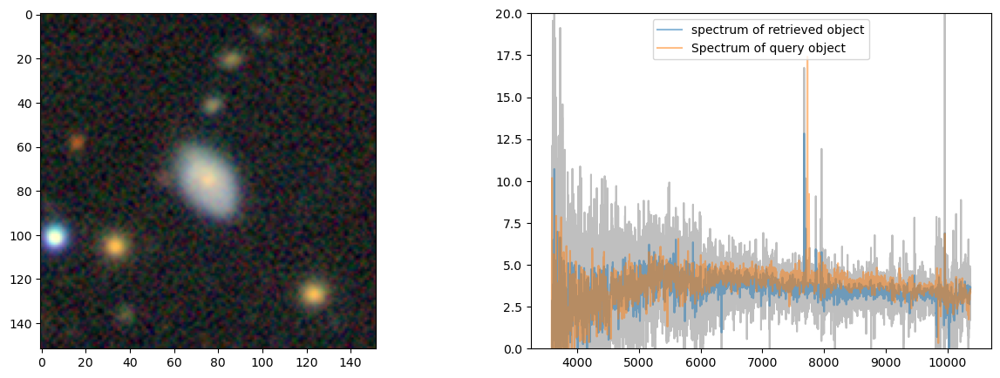

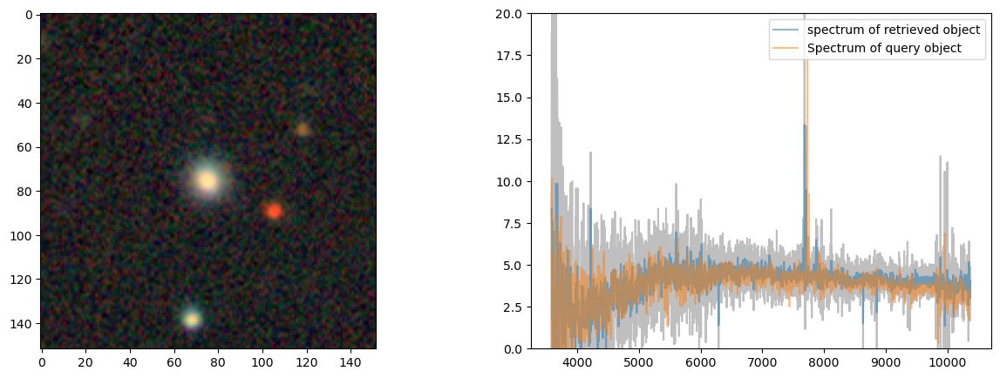

In [15]:
# Spectral self-similarity
s = spectral_similarity
inds = argsort(s)[::-1]
for i in range(5):
    figure(figsize=[15,5])
    subplot(121)
    imshow(images[inds[i]])
    subplot(122)
    plot(l,spectra[inds[i]], color='grey', alpha=0.5)
    plot(l,gaussian_filter1d(spectra[inds[i]][:,0],2),alpha=0.5, label='spectrum of retrieved object')
    plot(l,gaussian_filter1d(spectra[ind_query][:,0],2),alpha=0.5, label='Spectrum of query object')
    ylim(-0,20)
    legend()

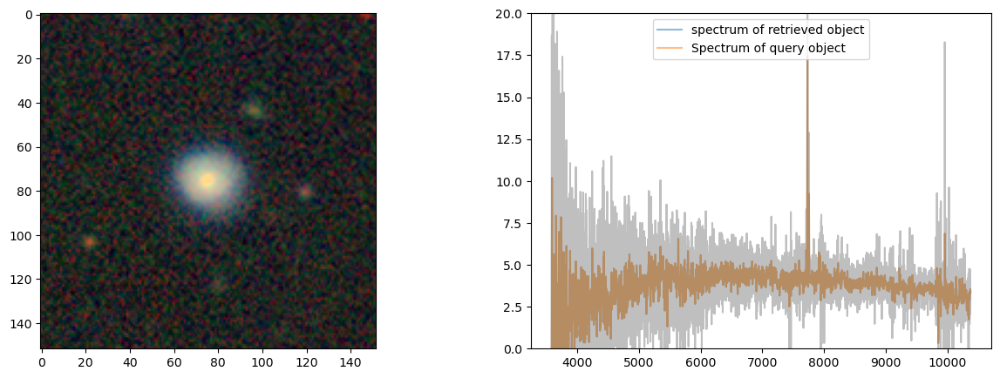

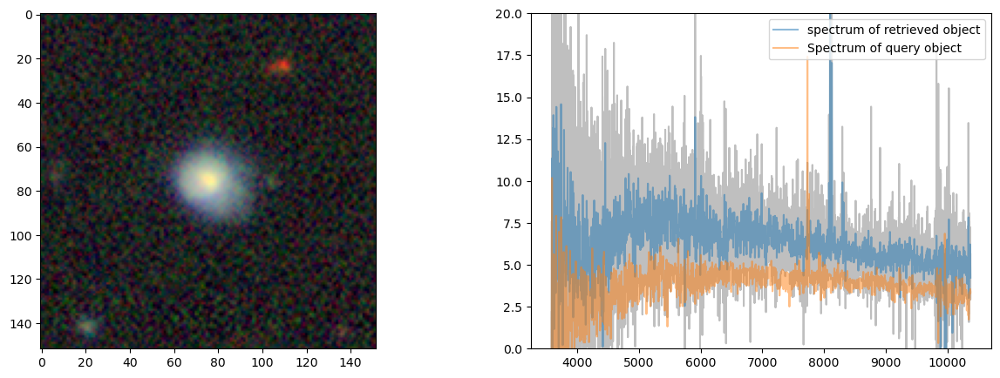

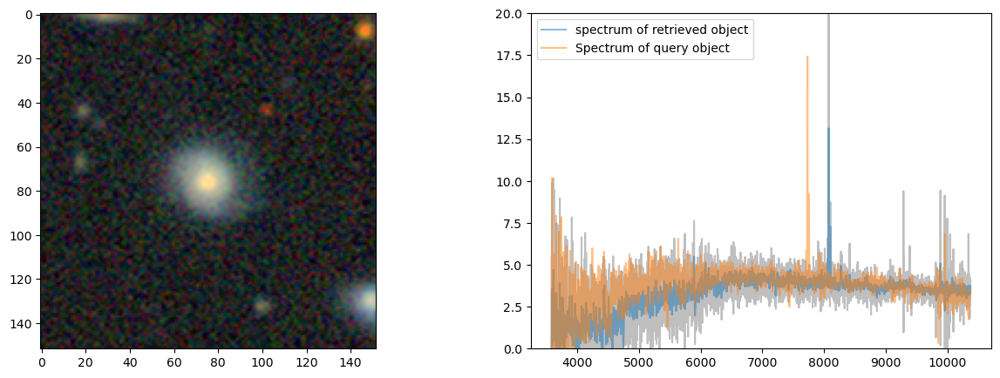

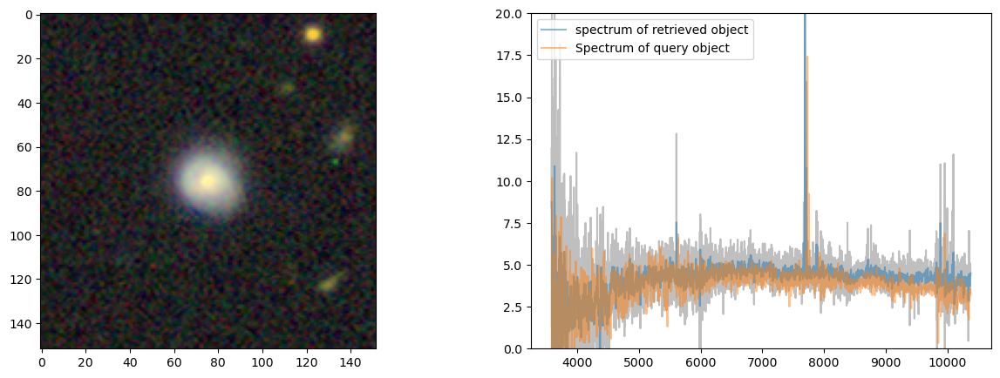

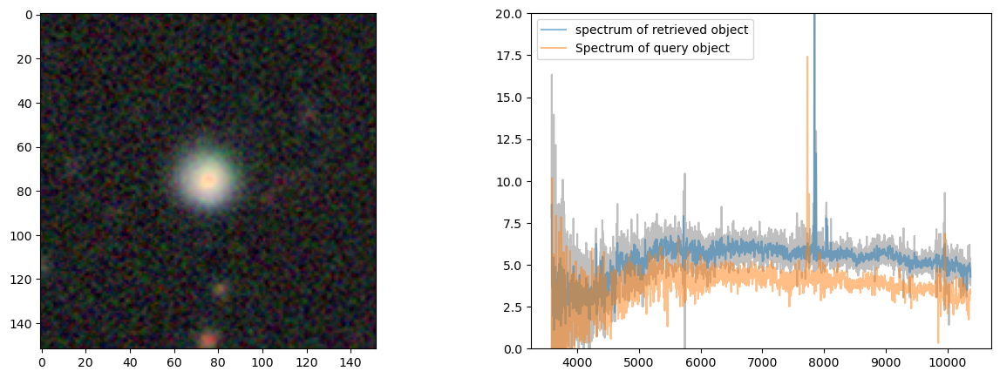

In [16]:
# Image self-similarity
s = image_similarity
inds = argsort(s)[::-1]
for i in range(5):
    figure(figsize=[15,5])
    subplot(121)
    imshow(images[inds[i]])
    subplot(122)
    plot(l,spectra[inds[i]], color='grey', alpha=0.5)
    plot(l,gaussian_filter1d(spectra[inds[i]][:,0],2),alpha=0.5, label='spectrum of retrieved object')
    plot(l,gaussian_filter1d(spectra[ind_query][:,0],2),alpha=0.5, label='Spectrum of query object')
    ylim(-0,20)
    legend()

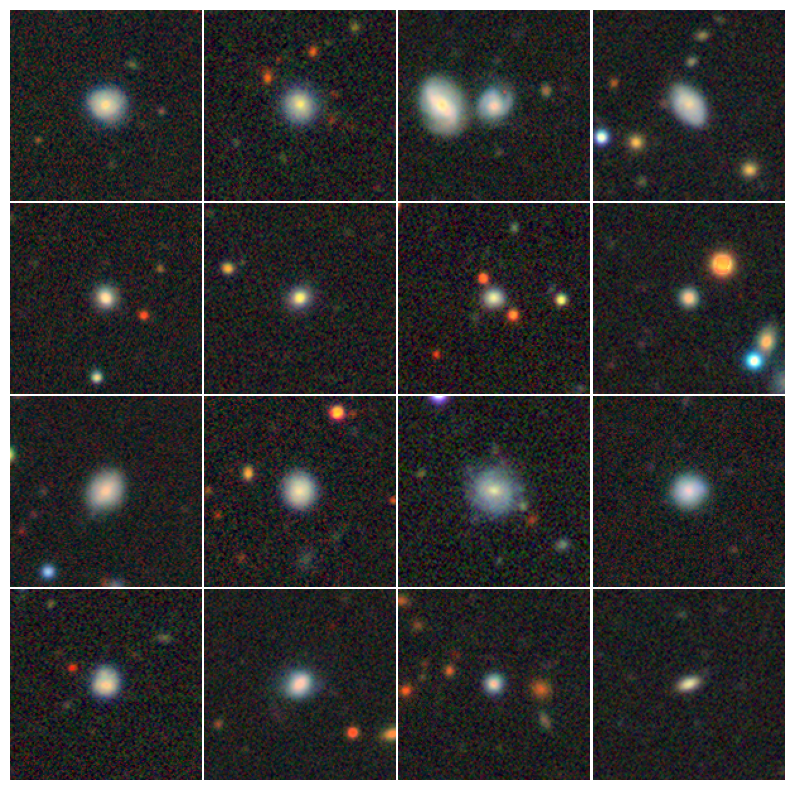

In [17]:
# Spectral similarity
s = spectral_similarity
inds = argsort(s)[::-1]
figure(figsize=[10,10])
for i in range(4):
    for j in range(4):
        subplot(4, 4, i * 4 +j +1)
        imshow(images[inds[i * 4 +j]])
        axis('off')
plt.subplots_adjust(wspace=0.01, hspace=0.01)

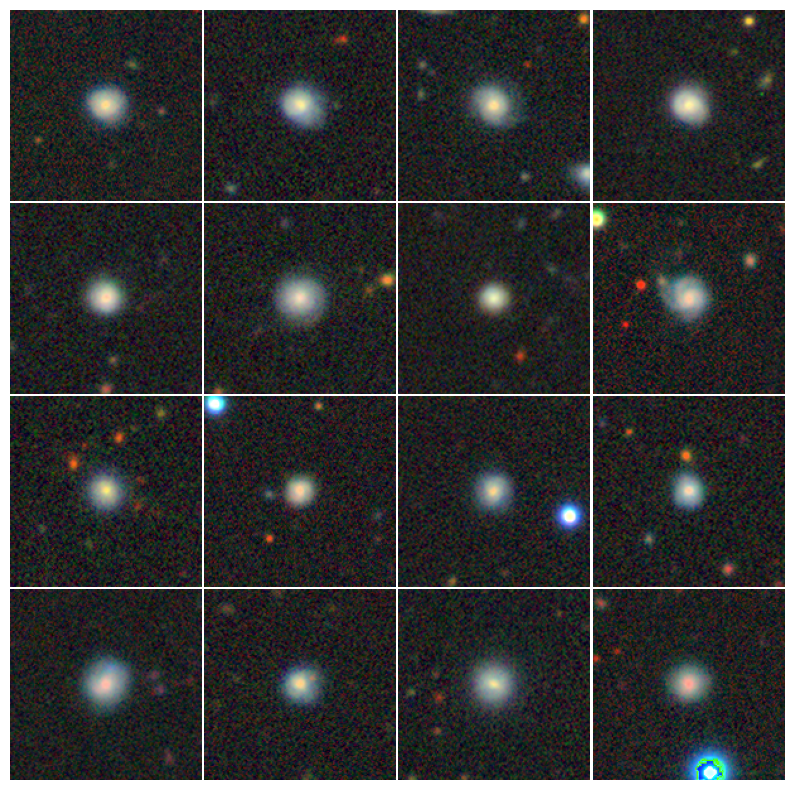

In [18]:
# Image similarity
s = image_similarity
inds = argsort(s)[::-1]
figure(figsize=[10,10])
for i in range(4):
    for j in range(4):
        subplot(4, 4, i * 4 +j +1)
        imshow(images[inds[i * 4 +j]])
        axis('off')
plt.subplots_adjust(wspace=0.01, hspace=0.01)

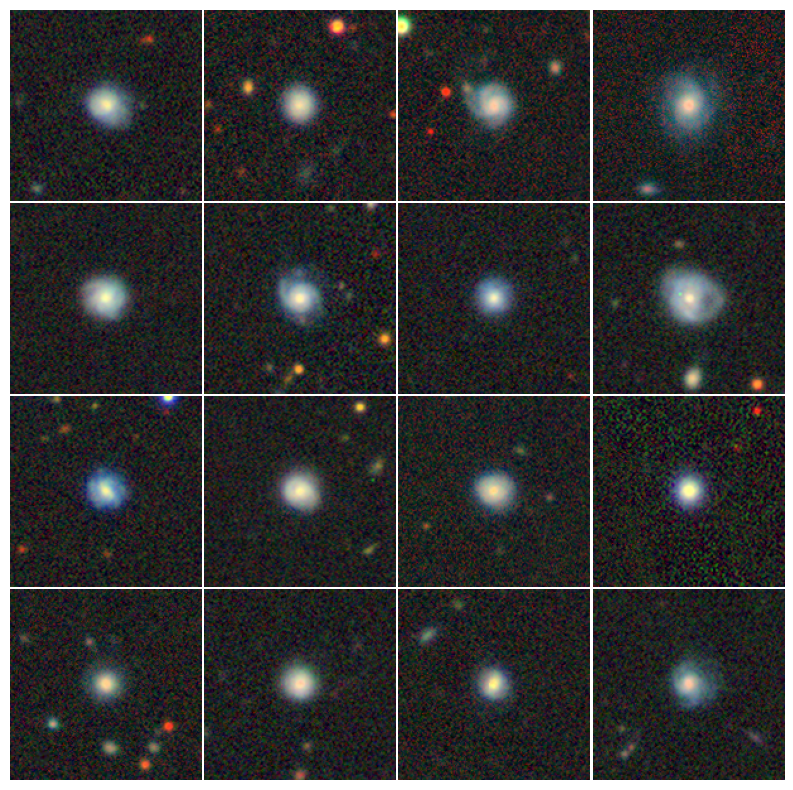

In [19]:
s = cross_spectral_similarity
inds = argsort(s)[::-1]
figure(figsize=[10,10])
for i in range(4):
    for j in range(4):
        subplot(4, 4, i * 4 +j +1)
        imshow(images[inds[i * 4 +j]])
        axis('off')
plt.subplots_adjust(wspace=0.01, hspace=0.01)

## Testing prediction of properties

In [20]:
from astropy.table import Table, join

In [21]:
provabgs = Table.read('/mnt/home/flanusse/ceph/BGS_ANY_full.provabgs.sv3.v0.hdf5')

# Joining by target ids
embedding_table = Table({'targetid': targetid, 'image_features': image_features, 'spectra_features': spectrum_features})
provabgs = join(provabgs, embedding_table, keys_left='TARGETID', keys_right='targetid')

In [22]:
# Further removing spurious entries
provabgs = provabgs[(provabgs['PROVABGS_LOGMSTAR_BF'] > 0) *
                   (provabgs['MAG_G'] > 0) *
                   (provabgs['MAG_R'] > 0) *
                   (provabgs['MAG_Z'] > 0)]

# Randomizing order to make sure we are fair
inds = np.random.permutation(len(provabgs))
provabgs = provabgs[inds]

In [23]:
print(len(provabgs))

21051


Text(9.2, 12, '$r^2$ score: 0.84')

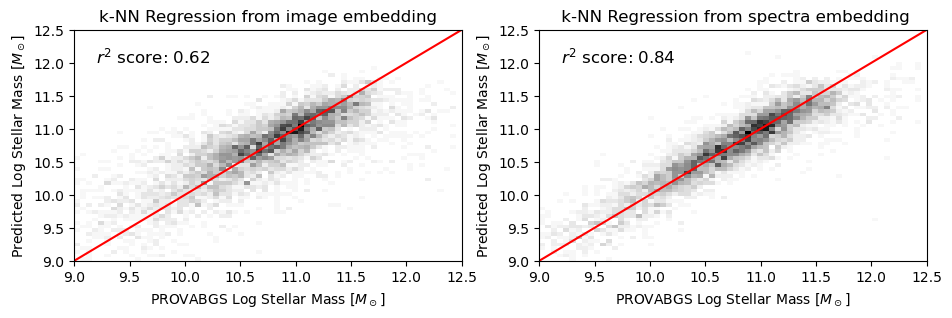

In [24]:
# Zero shot stellar mass prediction
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import r2_score

figure(figsize=[11, 3])
subplot(121)
neigh = KNeighborsRegressor(weights='distance', n_neighbors=5)
neigh.fit(provabgs['image_features'][:-5000], provabgs['PROVABGS_LOGMSTAR_BF'][:-5000])
preds = neigh.predict(provabgs['image_features'][-5000:])
hist2d(provabgs['PROVABGS_LOGMSTAR_BF'][-5000:], preds, 64,range=[[9,12.5], [9,12.5]], cmap='gray_r');
plot([8,13], [8,13], color='red')
title('k-NN Regression from image embedding')
xlabel('PROVABGS Log Stellar Mass $[M_\odot]$')
ylabel('Predicted Log Stellar Mass $[M_\odot]$')
text(9.2, 12, '$r^2$ score: %0.2f'%(r2_score(provabgs['PROVABGS_LOGMSTAR_BF'][-5000:], preds)), fontsize='large' )

subplot(122)
neigh = KNeighborsRegressor(weights='distance', n_neighbors=5)
neigh.fit(provabgs['spectra_features'][:-5000], provabgs['PROVABGS_LOGMSTAR_BF'][:-5000])
preds = neigh.predict(provabgs['spectra_features'][-5000:])
hist2d(provabgs['PROVABGS_LOGMSTAR_BF'][-5000:], preds, 64,range=[[9,12.5], [9,12.5]], cmap='gray_r');
plot([8,13], [8,13], color='red')
title(' k-NN Regression from spectra embedding')
xlabel('PROVABGS Log Stellar Mass $[M_\odot]$')
ylabel('Predicted Log Stellar Mass $[M_\odot]$')
text(9.2, 12, '$r^2$ score: %0.2f'%(r2_score(provabgs['PROVABGS_LOGMSTAR_BF'][-5000:], preds)), fontsize='large')
# savefig('m_pred_embeddings.pdf')

Text(0.05, 0.5, '$r^2$ score: 0.97')

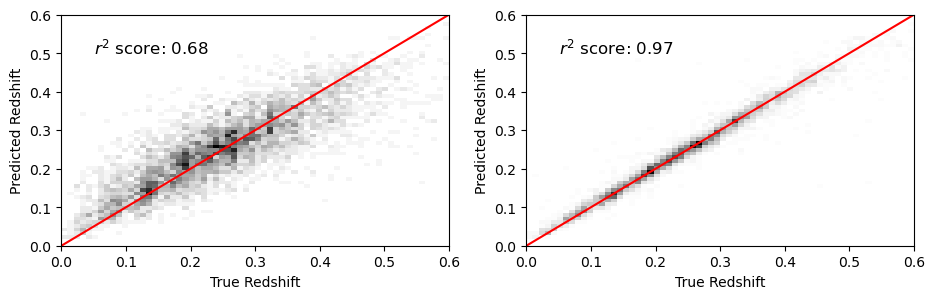

In [25]:
# Redshift prediction
figure(figsize=[11, 3])
subplot(121)
neigh = KNeighborsRegressor(weights='distance', n_neighbors=5)
neigh.fit(provabgs['image_features'][:-5000], provabgs['Z_HP'][:-5000])
preds = neigh.predict(provabgs['image_features'][-5000:])
hist2d(provabgs['Z_HP'][-5000:], preds, 64,range=[[0,0.6], [0,0.6]], cmap='gray_r');
plot([0,1], [0,1], color='red')
# title('k-Nearest Neighbors Regression (image embedding)')
ylabel('Predicted Redshift')
xlabel('True Redshift');
text(0.05, 0.5, '$r^2$ score: %0.2f'%(r2_score(provabgs['Z_HP'][-5000:], preds)), fontsize='large' )

subplot(122)
neigh = KNeighborsRegressor(weights='distance', n_neighbors=5)
neigh.fit(provabgs['spectra_features'][:-5000], provabgs['Z_HP'][:-5000])
preds = neigh.predict(provabgs['spectra_features'][-5000:])
hist2d(provabgs['Z_HP'][-5000:], preds,64,range=[[0,0.6], [0,0.6]], cmap='gray_r');
plot([0,1], [0,1], color='red')
# title('k-Nearest Neighbors Regression (spectra embedding)')
ylabel('Predicted Redshift')
xlabel('True Redshift');
text(0.05, 0.5, '$r^2$ score: %0.2f'%(r2_score(provabgs['Z_HP'][-5000:], preds)), fontsize='large' )
# savefig('z_pred_embeddings.pdf')

In [26]:
# Predicting redshift from 3 band photometry alone
import haiku as hk
import optax
from tqdm import tqdm
import jax.numpy as jnp
from jax import grad, jit, vmap
from jax import random
from jax import nn

class RedshiftHead(hk.Module):
  def __call__(self, x):
    """ 
    x: array, scale, normalized to fftfreq default
    """
    net = nn.leaky_relu(hk.Linear(512)(x))
    net = nn.leaky_relu(hk.Linear(512)(net))  
    net = hk.Linear(1)(net)
    return net

In [21]:
model = hk.without_apply_rng(hk.transform(lambda x : RedshiftHead()(x)))
rng_seq = hk.PRNGSequence(12)
params = model.init(next(rng_seq), jnp.zeros([1, 3])) # Input is going to be 3 band photometry

def loss_fn(params, batch):
  preds = model.apply(params, batch['x'])
  return jnp.mean((preds.squeeze() - batch['y'].squeeze())**2)

@jax.jit
def update(params, opt_state, batch):
    """Single SGD update step."""
    loss, grads = jax.value_and_grad(loss_fn)(params, batch)
    updates, new_opt_state = optimizer.update(grads, opt_state)
    new_params = optax.apply_updates(params, updates)
    return loss, new_params, new_opt_state

learning_rate=0.001
optimizer = optax.adam(learning_rate)
opt_state = optimizer.init(params)

NameError: name 'jax' is not defined

In [150]:
losses = []

In [151]:
from sklearn.preprocessing import StandardScaler

photometry = np.stack([provabgs['MAG_G'], provabgs['MAG_R'], provabgs['MAG_Z']], axis=1)
x_scaler = StandardScaler().fit(photometry)
y_scaler = StandardScaler().fit(provabgs['PROVABGS_LOGMSTAR_BF'].reshape([-1,1]))

x = x_scaler.transform(photometry)
y = y_scaler.transform(provabgs['PROVABGS_LOGMSTAR_BF'].reshape([-1,1]))


for step in tqdm(range(20000)):
  inds = choice(15_000, 128, replace=False)  
  l, params, opt_state = update(params, opt_state, {'x': x[inds], 
                                                    'y': y[inds]})
  losses.append(l)

100%|██████████| 20000/20000 [00:28<00:00, 711.93it/s]


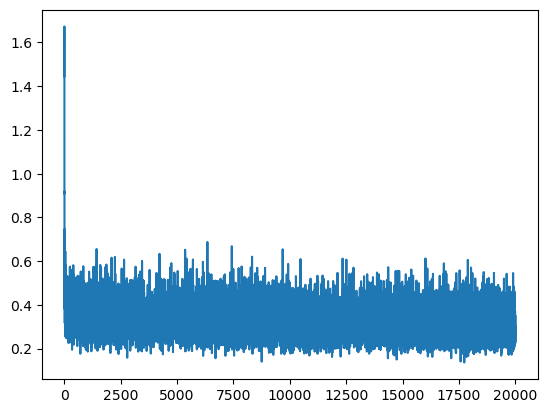

In [152]:
plot(losses[:])

Text(9.2, 12, '$r^2$ score: 0.65')

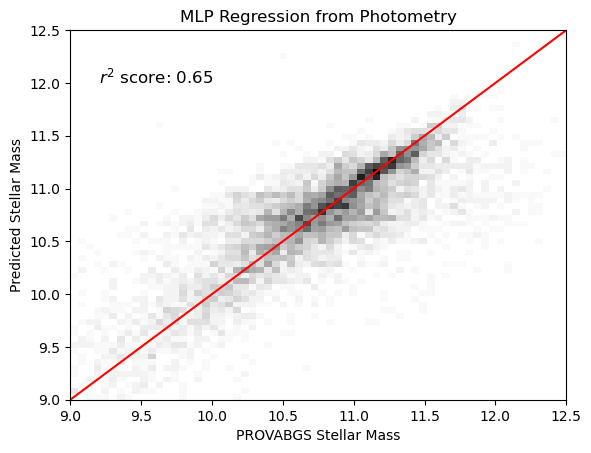

In [155]:
preds = y_scaler.inverse_transform(model.apply(params, x[15000:])).squeeze()
hist2d(provabgs['PROVABGS_LOGMSTAR_BF'][15000:], preds,  64,range=[[9,12.5], [9,12.5]], cmap='gray_r');
plot([8,13], [8,13], color='red')
title('MLP Regression from Photometry')
xlabel('PROVABGS Stellar Mass')
ylabel('Predicted Stellar Mass')
text(9.2, 12, '$r^2$ score: %0.2f'%(r2_score(provabgs['PROVABGS_LOGMSTAR_BF'][15000:], preds)),  fontsize='large' )

In [156]:
model = hk.without_apply_rng(hk.transform(lambda x : RedshiftHead()(x)))
rng_seq = hk.PRNGSequence(12)
params = model.init(next(rng_seq), jnp.zeros([1, 3])) # Input is going to be 3 band photometry

def loss_fn(params, batch):
  preds = model.apply(params, batch['x'])
  return jnp.mean((preds.squeeze() - batch['y'].squeeze())**2)

@jax.jit
def update(params, opt_state, batch):
    """Single SGD update step."""
    loss, grads = jax.value_and_grad(loss_fn)(params, batch)
    updates, new_opt_state = optimizer.update(grads, opt_state)
    new_params = optax.apply_updates(params, updates)
    return loss, new_params, new_opt_state

learning_rate=0.0002
optimizer = optax.adam(learning_rate)
opt_state = optimizer.init(params)

In [157]:
losses = []

photometry = np.stack([provabgs['MAG_G'], provabgs['MAG_R'], provabgs['MAG_Z']], axis=1)
x_scaler = StandardScaler().fit(photometry)
y_scaler = StandardScaler().fit(provabgs['Z_HP'].reshape([-1,1]))

for step in tqdm(range(20000)):
  inds = choice(15_000, 128, replace=False)  
  l, params, opt_state = update(params, opt_state, {'x': x_scaler.transform(photometry[inds]), 
                                                    'y': y_scaler.transform(provabgs['Z_HP'][inds].reshape([-1,1]))})
  losses.append(l)

100%|██████████| 20000/20000 [00:35<00:00, 570.67it/s]


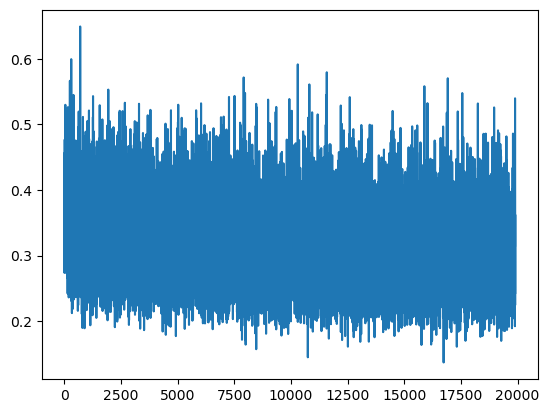

In [158]:
plot(losses[100:])

Text(0.05, 0.5, '$r^2$ score: 0.69')

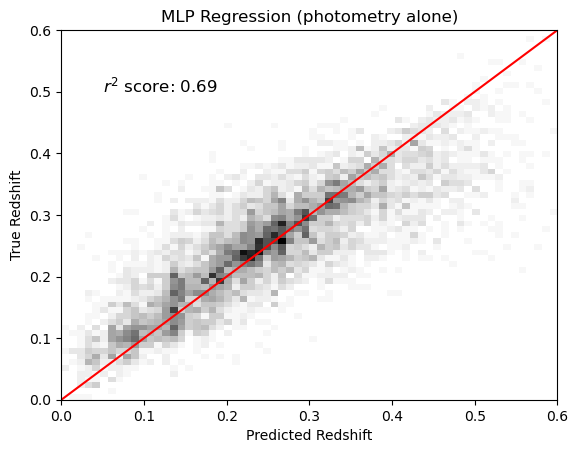

In [162]:
preds = y_scaler.inverse_transform(model.apply(params, x_scaler.transform(photometry[15000:]))).squeeze()

hist2d(provabgs['Z_HP'][15000:], preds,  64,range=[[0,0.6], [0,0.6]], cmap='gray_r');
plot([0,1], [0,1], color='red')
title('MLP Regression (photometry alone)')
xlabel('Predicted Redshift')
ylabel('True Redshift');
text(0.05, 0.5, '$r^2$ score: %0.2f'%(r2_score(provabgs['Z_HP'][15000:], preds)),  fontsize='large' )

In [104]:
# Try to train a neural network to do the same prediction from the embeddings
model = hk.without_apply_rng(hk.transform(lambda x : RedshiftHead()(x)))
rng_seq = hk.PRNGSequence(12)
params = model.init(next(rng_seq), jnp.zeros([1, 128])) # Input is going to be 3 band photometry

def loss_fn(params, batch):
  preds = model.apply(params, batch['x'])
  return jnp.mean((preds.squeeze() - batch['y'].squeeze())**2)

@jax.jit
def update(params, opt_state, batch):
    """Single SGD update step."""
    loss, grads = jax.value_and_grad(loss_fn)(params, batch)
    updates, new_opt_state = optimizer.update(grads, opt_state)
    new_params = optax.apply_updates(params, updates)
    return loss, new_params, new_opt_state

learning_rate=0.0002
optimizer = optax.adam(learning_rate)
opt_state = optimizer.init(params)

In [109]:
losses = []

y_scaler = StandardScaler().fit(provabgs['Z_HP'].reshape([-1,1]))

for step in tqdm(range(20000)):
  inds = choice(15_000, 128, replace=False)  
  l, params, opt_state = update(params, opt_state, {'x': provabgs['image_features'][inds],
                                                    'y': y_scaler.transform(provabgs['Z_HP'][inds].reshape([-1,1]))})
  losses.append(l)

100%|██████████| 20000/20000 [00:40<00:00, 496.93it/s]


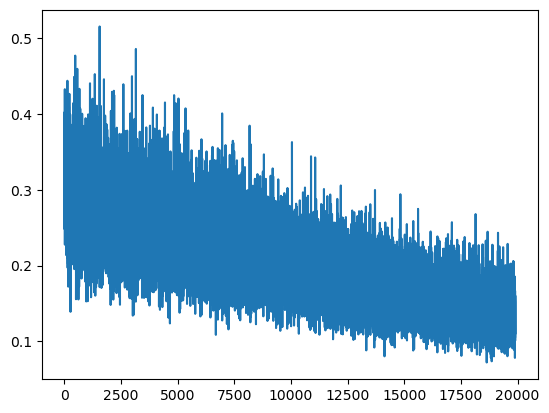

In [107]:
plot(losses[100:])

Text(0.05, 0.7, '$r^2$ score: 0.68')

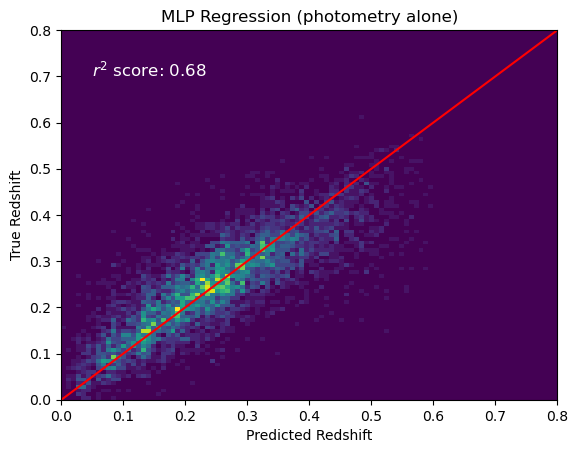

In [108]:
preds = y_scaler.inverse_transform(model.apply(params, provabgs['image_features'][15000:])).squeeze()

hist2d(provabgs['Z_HP'][15000:], preds, 100,range=[[0,0.8], [0,0.8]]);
plot([0,1], [0,1], color='red')
title('MLP Regression (photometry alone)')
xlabel('Predicted Redshift')
ylabel('True Redshift');
text(0.05, 0.7, '$r^2$ score: %0.2f'%(r2_score(provabgs['Z_HP'][15000:], preds)), color='white', fontsize='large' )